# Image Classification

Tumor Detection:
- The dataset is for tumor detection.
- To download the dataset, click on the following link.
- [TDC](https://www.kaggle.com/datasets/davidbroberts/brain-tumor-object-detection-datasets/download?datasetVersionNumber=5)

# Uploading the data

In [1]:
import os
from PIL import Image
import numpy as np
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
from tensorflow.keras import layers, models


image_folder_path = r'C:\Users\ARASOFT\Downloads\axial_t1wce_2_class\images\train'
label_folder_path = r'C:\Users\ARASOFT\Downloads\axial_t1wce_2_class\labels\train'


# List all image files in the image folder
image_files = [file for file in os.listdir(image_folder_path) if file.lower().endswith('.jpg')]

# Preprocessing

In this section we did the followings:
1. Neglected the unlabeled images.
2. Resized the images (not all of them had the same size).
3. Made images np arrays.
4. Selected the labels from text fiels (If you check the text fiels, there are 5 numbers, only the first integer is the label).

In [2]:
# Initialize a list to store image arrays and labels
data = []

# Desired size
target_size = (225, 225)

# Loop through each image file and process
for image_file in image_files:
    # Construct the full path to the image file
    image_path = os.path.join(image_folder_path, image_file)

    # Construct the full path to the label file
    label_file_path = os.path.join(label_folder_path, image_file.replace('.jpg', '.txt'))

    # Check if the label file exists
    if os.path.exists(label_file_path):
        # Open and resize the image
        image = Image.open(image_path)
        resized_image = image.resize(target_size)
        resized_image_array = np.array(resized_image)

        with open(label_file_path, 'r') as label_file:
            # Read the first number (already an int)
            label = int(label_file.readline().strip().split()[0])

        # Append the image array and label to the list
        data.append((resized_image_array, label))

# Convert the list of image arrays and labels to NumPy arrays
image_arrays, labels = zip(*data)
image_arrays = np.array(image_arrays)
labels = np.array(labels)

What we achieved here?
1. Now, 'image_arrays' contains NumPy arrays of all the resized images.
2. 'labels' contains the corresponding labels (integer).

- Simple train,val split.
- As you know, 2d CNNs recieve a 3d data in their first layer. We changed the size of images to 225,225. Now we add the 3d dime.

In [3]:
# Assuming you have image_arrays and labels as NumPy arrays

# Split the data into training and validation sets
X_train, X_val, y_train, y_val = train_test_split(image_arrays, labels, test_size=0.2, random_state=42)
# Reshape the images to (225, 225, 1)
X_train_processed = X_train.reshape(-1, 225, 225, 1)
X_val_processed = X_val.reshape(-1, 225, 225, 1)

# Data Visualization

It is important to plot images with labels in biomedical datasets.

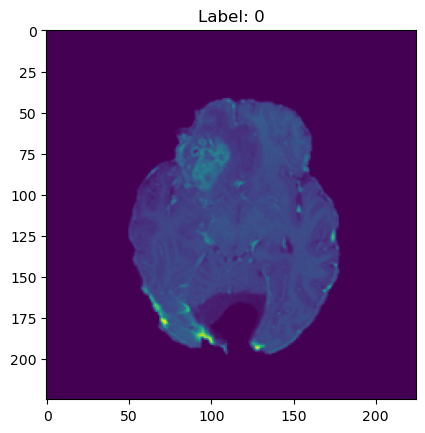

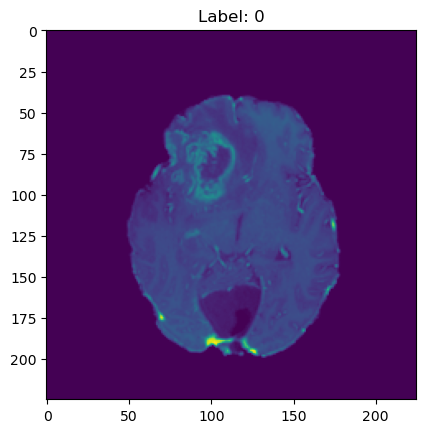

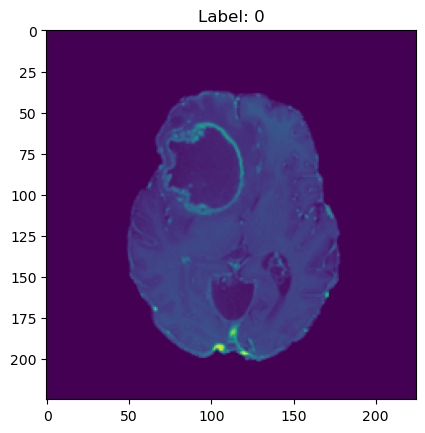

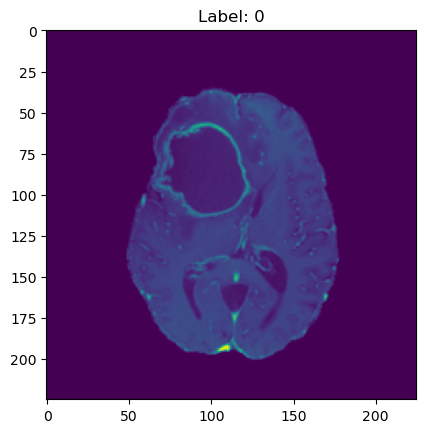

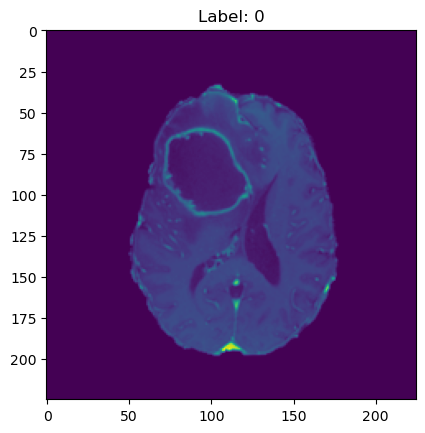

...

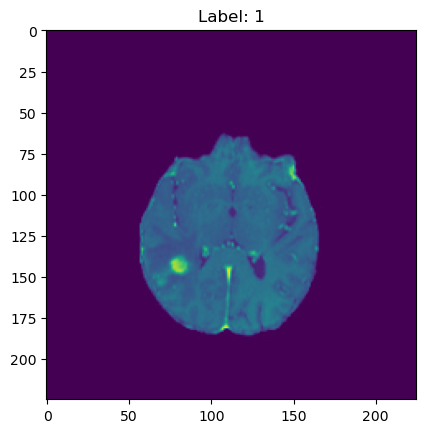

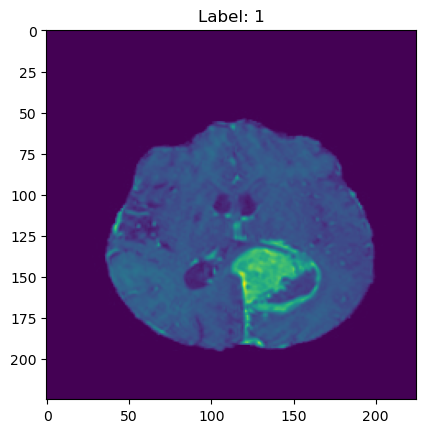

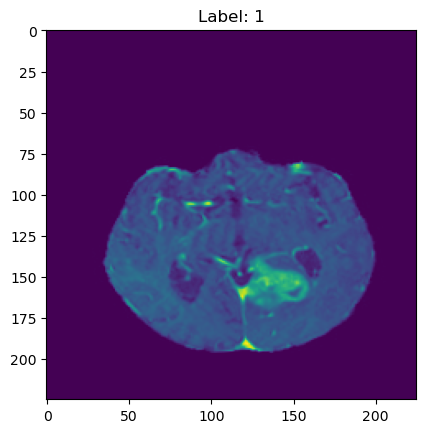

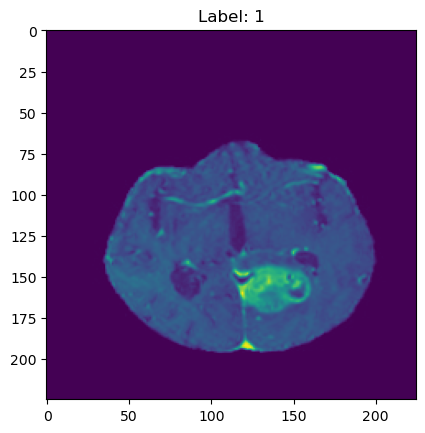

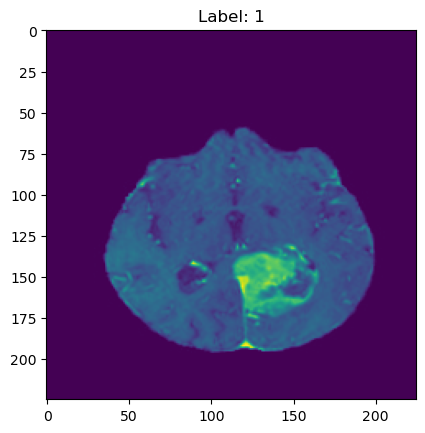

In [4]:
# Assuming 'image_arrays' is a NumPy array containing image arrays

# Reshape the image arrays if you changed the shape
# For example, if your images are grayscale and have shape (height, width), you can reshape them to (height, width, 1)
image_arrays_reshaped = image_arrays.reshape(image_arrays.shape + (1,)) if len(image_arrays.shape) == 2 else image_arrays

# Loop through each image and display it
for i in range(len(image_arrays_reshaped)):
    plt.imshow(image_arrays_reshaped[i])
    plt.title(f"Label: {labels[i]}")
    plt.show()


# Defining our CNN Model and Train it

I used 3 layers of CNN with MaxPooling and a 128 Dense at the end. Adding a dropout layer is always helpful for preventing overfitting.

In [5]:
# Define the CNN model
model = models.Sequential()
model.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(225, 225, 1)))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(64, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(128, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Flatten())
model.add(layers.Dense(128, activation='relu'))
model.add(layers.Dropout(0.2))
model.add(layers.Dense(1, activation='sigmoid'))  # Assuming binary classification

# Compile the model
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Train the model
r = model.fit(X_train_processed, y_train, epochs=10, validation_data=(X_val_processed, y_val))

Epoch 1/10
8/8 [==============================] - 8s 937ms/step - loss: 65.1836 - accuracy: 0.4831 - val_loss: 0.6700 - val_accuracy: 0.5500
Epoch 2/10
8/8 [==============================] - 7s 857ms/step - loss: 0.5469 - accuracy: 0.7246 - val_loss: 0.5050 - val_accuracy: 0.7667
Epoch 3/10
8/8 [==============================] - 7s 852ms/step - loss: 0.4369 - accuracy: 0.8220 - val_loss: 0.3667 - val_accuracy: 0.8667
Epoch 4/10
8/8 [==============================] - 7s 911ms/step - loss: 0.2773 - accuracy: 0.8941 - val_loss: 0.2824 - val_accuracy: 0.8833
Epoch 5/10
8/8 [==============================] - 7s 852ms/step - loss: 0.2398 - accuracy: 0.9153 - val_loss: 0.3080 - val_accuracy: 0.8833
Epoch 6/10
8/8 [==============================] - 7s 863ms/step - loss: 0.1191 - accuracy: 0.9619 - val_loss: 0.2887 - val_accuracy: 0.8833
Epoch 7/10
8/8 [==============================] - 7s 864ms/step - loss: 0.0838 - accuracy: 0.9788 - val_loss: 0.3250 - val_accuracy: 0.8667
Epoch 8/10
8/8 [===

# Testing our Model

Same process that we did for train.

In [6]:
# Specify the path to your image and label folders
image_folder_path_test = r'C:\Users\ARASOFT\Downloads\axial_t1wce_2_class\images\test'
label_folder_path_test = r'C:\Users\ARASOFT\Downloads\axial_t1wce_2_class\labels\test'


# List all image files in the image folder
image_files = [file for file in os.listdir(image_folder_path) if file.lower().endswith('.jpg')]

# Initialize a list to store image arrays and labels
data = []

# Desired size
target_size = (225, 225)

# Loop through each image file and process
for image_file in image_files:
    # Construct the full path to the image file
    image_path = os.path.join(image_folder_path, image_file)

    # Construct the full path to the label file
    label_file_path = os.path.join(label_folder_path, image_file.replace('.jpg', '.txt'))

    # Check if the label file exists
    if os.path.exists(label_file_path):
        # Open and resize the image
        image = Image.open(image_path)
        resized_image = image.resize(target_size)
        resized_image_array = np.array(resized_image)

        with open(label_file_path, 'r') as label_file:
            # Read the first number (already an int)
            label = int(label_file.readline().strip().split()[0])

        # Append the image array and label to the list
        data.append((resized_image_array, label))

# Convert the list of image arrays and labels to NumPy arrays
image_arrays, labels = zip(*data)
image_arrays = np.array(image_arrays)
labels = np.array(labels)

# Now, 'image_arrays' contains NumPy arrays of all the resized images,
# and 'labels' contains the corresponding labels (integer)

In [7]:
# Assuming you have image_arrays and labels as NumPy arrays


# Reshape the images to (225, 225, 3)
X_test = image_arrays.reshape(-1, 225, 225, 1)
y_test = labels

# Define the CNN model
test_loss, test_accuracy = model.evaluate(X_test, y_test)
print(f'Test Accuracy: {test_accuracy*100:.2f}%')

10/10 [==============================] - 2s 159ms/step - loss: 0.0499 - accuracy: 0.9865
Test Accuracy: 98.65%


10/10 [==============================] - 2s 183ms/step


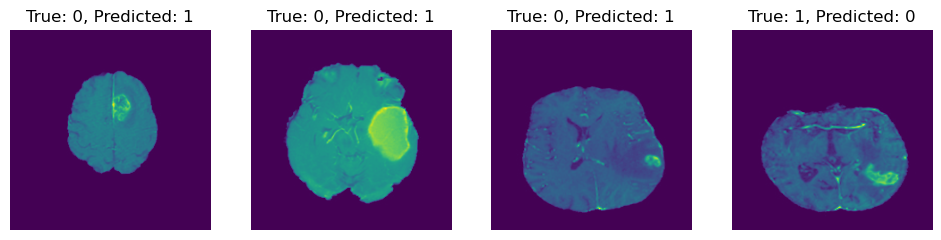

In [8]:
# Assuming you have the trained model and test data (X_test_processed, y_test) available

# Get model predictions for the test data
y_pred = model.predict(X_test)

# Convert predicted probabilities to binary labels (0 or 1)
y_pred_binary = np.round(y_pred)

# Find misclassified samples
y_pred_binary = np.reshape(y_pred_binary, (296, )).astype(int)

misclassified_indices = []

for i in range(0, y_test.shape[0]):
    if y_pred_binary[i] != y_test[i]:
        misclassified_indices.append(i)
# Number of misclassified samples to visualize
num_samples_to_visualize = min(10, len(misclassified_indices))

# Plot the misclassified samples
plt.figure(figsize=(15, 8))
for i in range(num_samples_to_visualize):
    index = misclassified_indices[i]
    true_label = y_test[index]
    predicted_label = y_pred_binary[index]

    plt.subplot(2, 5, i + 1)
    plt.imshow(X_test[index])
    plt.title(f'True: {int(true_label)}, Predicted: {int(predicted_label)}')
    plt.axis('off')

plt.show()